In [1]:
import datetime
import sys, os
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

In [2]:
import scanpy as sc
sc.logging.print_memory_usage()
sc.settings.verbosity = 2
sc.settings.set_figure_params(dpi = 300, dpi_save = 300)
sc.logging.print_header()

from matplotlib.pyplot import rc_context

Memory usage: current 0.21 GB, difference +0.21 GB
scanpy==1.10.2 anndata==0.10.8 umap==0.5.5 numpy==1.26.4 scipy==1.13.0 pandas==2.0.3 scikit-learn==1.4.2 statsmodels==0.14.2 igraph==0.11.6 pynndescent==0.5.13


In [3]:
# add the utility functions folder to PATH
sys.path.append(os.path.abspath("../packages"))
from db_dev.helper import *
from db_dev.plotting import *

In [4]:
import matplotlib as mpl
mpl.rc("font", family = "Arial")
mpl.rcParams["pdf.fonttype"] = 42
mpl.rcParams["ps.fonttype"] = 42


In [5]:
#load data with leiden
#home_dir = os.path.expanduser("~")
current_directory = os.getcwd()
adata = sc.read_h5ad(current_directory+"/backups/bb2_bb3_leiden_2.5_sub_DGE_refined_annotation_86447x37733_241107_10h51.h5ad")

In [6]:
#Loading obs
current_directory = os.getcwd()
# overwrite obs with the most recent version
filename = current_directory+"/backups/anno_obs_info_86447x39_250127_18h19.npz"
encoding = "latin1"

with np.load(filename, encoding=encoding, allow_pickle = True) as f:
    obs = pd.DataFrame(**f)

In [7]:
obs_cell_type_sub_prolif_anno = obs[["barcode", "library", "cell_type_sub_prolif_anno"]]

In [8]:
# Perform a left join
updated_obs = adata.obs.merge(obs_cell_type_sub_prolif_anno, on=["library", "barcode"], how="left")

# Update the adata.obs with the new annotations
adata.obs = updated_obs


In [10]:
# Recode
renamer_sample = {
    "WBC5": "HD1",
    "WBC5_D": "HD4",
    "1-FM02-NP0000008": "HD2",
    "2-FM02-NP0000011": "HD3",
    
    "1-FM02-NP0000004": "GCSF1",
    "2-FM02-NP0000012": "GCSF2",
    "1-FM02-NP0000026": "GCSF3",
    "1-FM02-NP0000027": "GCSF4",
    "1-FM02-NP0000039": "GCSF5",

    "1-FM02-NP0000010": "AML1",
    "1-FM02-NP0000014": "AML2",
    "5-FM02-NP0000024": "AML3",
    "1-FM02-NP0000029": "AML4",
    "1-FM02-NP0000032": "AML5",
    "1-FM02-NP0000041": "AML6",
    "1-FM02-NP0000045": "AML7",
    "1-FM02-NP0000046": "AML8",
    
    "1;2-FM02-NP0000042": "NT1-1",
    "5;6-FM02-NP0000042": "NT1-2",
    "1;2-FM02-NP0000036": "NT2-1",
    "5-FM02-NP0000036": "NT2-2",
    "1;2-FM02-NP0000034": "NT4-1",
    "5;6-FM02-NP0000034": "NT4-2",
    "1;2;5;6-FM02-NP0000049": "NT7-1",
    "1;2-FM02-NP0000050": "NT8-1",
    "5;6-FM02-NP0000050": "NT8-2",

    "5;6-FM02-NP0000035": "NT9-1",
    "5;6-FM02-NP0000037": "NT10-1",
    "1;2-FM02-NP0000043": "NT11-1"

}
adata.obs["code_renamed"] = [renamer_sample[i] for i in adata.obs["code"]]


renamer_sample = {
    "KC":"HD",
    "GF":"GCSF",
    "UL":"AML",
    "NT":"NT"
}
adata.obs["sample_renamed"] = [renamer_sample[i] for i in adata.obs["sample"]]


In [12]:
cell_type_color_palette = {

"AML cells 1": "#73472a",
"AML cells 2": "#9e5423",
"AML cells 3": "#ab3803",
"AML cells 4": "#eb8f1e",
"AML cells 5": "#f2621f",
"AML cells 6": "#ad0e0e",
"AML cells 7": "#cc1c00",
"AML cells 8": "#db5a46",
"AML cells 9": "#b85c38",
"AML cells 10": "#e07c57",
"Cycling AML cells 1": "#bf4a2e",
"Cycling AML cells 2": "#d96e3a",

"AML Monocytes 1": "#8a0303",
"AML Monocytes 2": "#ff7043",
"Cycling AML Monocytes": "#c4371d",

"Platelets": "#b06c6c",
"Erythrocytes": "#db2f2c",

"Naive B cells": "#f2836f",
"Memory B cells": "#d65a5a",
"Plasma cells": "#820505",
"Cycling B cells": "#a83232",

"CD14 Monocytes": "#2041c7",
"CD16 Monocytes": "#007bff",
"cDC": "#477ead",
"pDC": "#602ab0", 
    
"Basophils": "#2d4173",

"Precursors of Neutrophils": "#84619c",
"Early Immature Neutrophils": "#d658f5",
"Immature Neutrophils": "#9846a8",
"Mature Neutrophils": "#532b6b",
"Aged Neutrophils": "#943886",

"Tem/Temra cytotoxic T cells": "#596e32",
"Tem/Effector helper T cells": "#4f9e58",
"Tcm/Naive helper T cells": "#1b544c",
"Tcm/Naive cytotoxic T cells": "#21661e",
"MAIT T cells": "#62a87e", 
"Regulatory T cells": "#44ab89",
"Cycling T cells" : "#2abf9a",
"NK cells": "#3bad48",
    
}


code_color_palette = {
"HD": "#3bad48",
"GCSF": "#943886",
"AML": "#c96a6a",
"NT": "#477ead"
}

/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWar

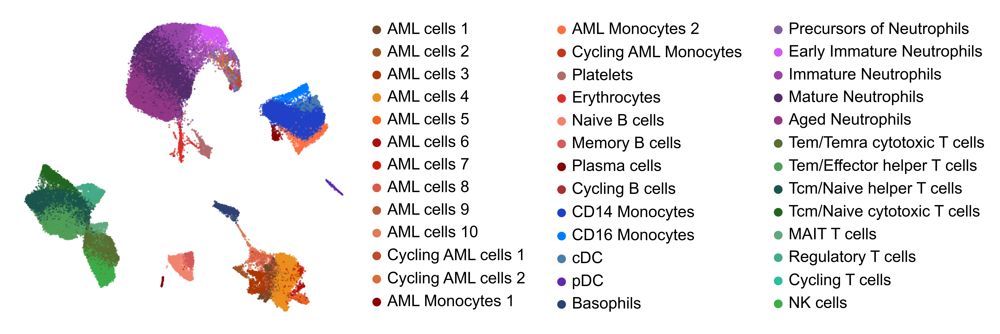

In [15]:
sc.settings.set_figure_params(dpi = 300, 
                              dpi_save = 1200, 
                              transparent = True, 
                              figsize = (5, 5), 
                              vector_friendly = False)



# To randomize cells
np.random.seed(69)
random_indices = np.random.permutation(list(range(adata.shape[0])))



adata.obs["cell_type_ordered"] = pd.Categorical(values = adata.obs.cell_type_sub_prolif_anno, categories = cell_type_color_palette.keys(), ordered = True)



fig = sc.pl.umap(adata[random_indices, :], color = "cell_type_ordered", 
                 alpha = 0.66, 
                 #wspace = 0.5,
                 #ncols = 2,
                 #vmax = "p90",
                 s = 10,
                 frameon = False, title = "",
                 #legend_loc = "on data", 
                 #legend_fontsize = 10, 
                 #legend_fontoutline = True,
                 palette = cell_type_color_palette,
                 show = False, return_fig = True)

fig.axes[0].set_aspect("equal")

fig.savefig("figures/final/figure_umap_cell_type_refined_v5.pdf", bbox_inches="tight")



adata.obs.drop("cell_type_ordered", axis = 1, inplace = True)

/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWar

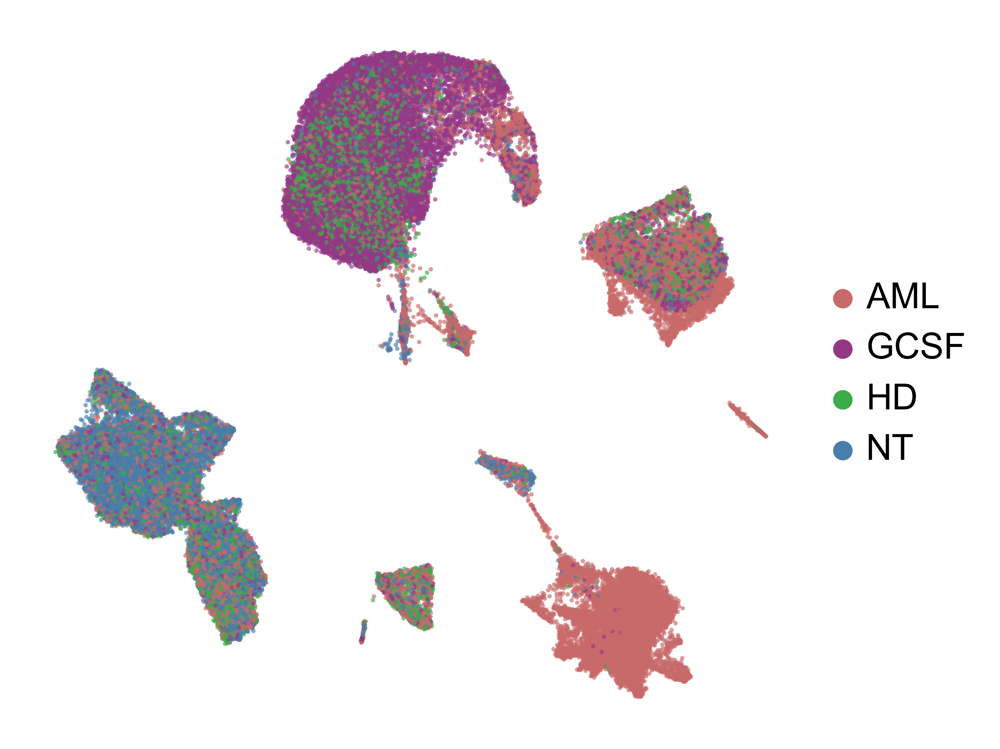

In [25]:
sc.settings.set_figure_params(dpi = 300, 
                              dpi_save = 1200, 
                              transparent = True, 
                              figsize = (5, 5), 
                              vector_friendly = False)




# To randomize cells
np.random.seed(69)
random_indices = np.random.permutation(list(range(adata.shape[0])))



fig = sc.pl.umap(adata[random_indices, :], color = "sample_renamed", 
                 alpha = 0.66, 
                 s = 10,
                 frameon = False, title = "",
                 palette = code_color_palette,
                 show = False, return_fig = True)


fig.axes[0].set_aspect("equal")

fig.savefig("figures/final/figure_umap_sample_refined_v3.pdf", bbox_inches="tight")


/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWar

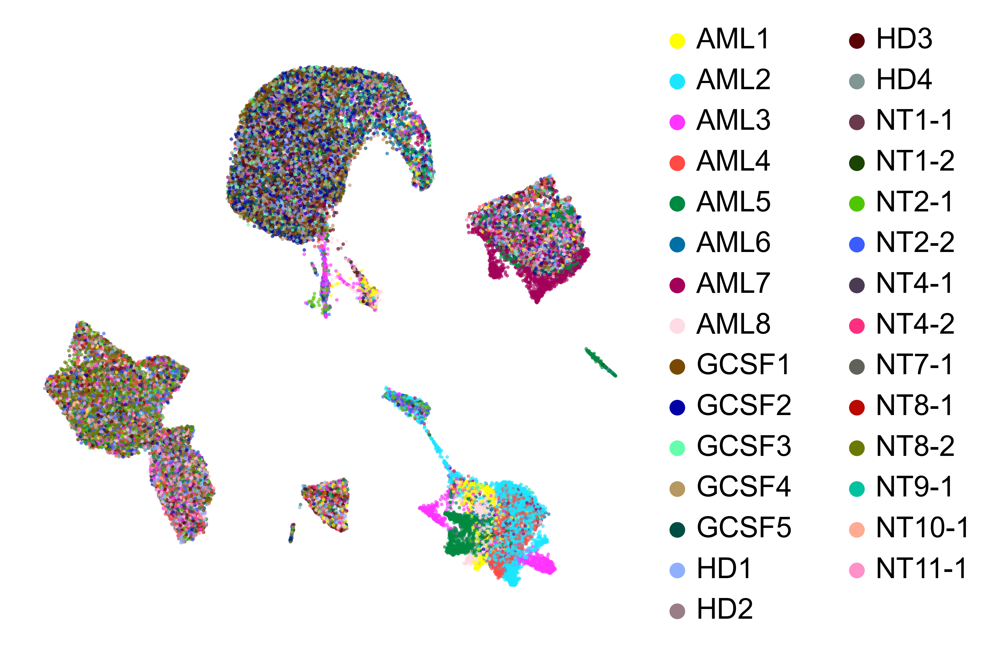

In [14]:
sc.settings.set_figure_params(dpi = 300, 
                              dpi_save = 1200, 
                              transparent = True, 
                              figsize = (5, 5), 
                              vector_friendly = False)



# To randomize cells
np.random.seed(69)
random_indices = np.random.permutation(list(range(adata.shape[0])))

fig = sc.pl.umap(adata[random_indices, :], color = "code_renamed", 
                 alpha = 0.66, 
                 #wspace = 0.5,
                 #ncols = 2,
                 #vmax = "p90",
                 s = 10,
                 frameon = False, title = "",
                 #legend_loc = "on data", 
                 #legend_fontsize = 10, 
                 #legend_fontoutline = True,
                 #palette = code_color_palette,
                 show = False, return_fig = True)

fig.axes[0].set_aspect("equal")
fig.savefig("figures/final/figure_umap_code_refined_v6_fn.pdf", bbox_inches="tight")


In [17]:
category_colors = list(cell_type_color_palette.values()) 
category_names =  list(cell_type_color_palette.keys())

results = {}
for i in adata.obs["code_renamed"].unique():
    percentages = []
    results.update({i : percentages})
    for j in category_names:
        cmask = adata.obs["code_renamed"].isin([i]).values
        tmask = adata.obs["cell_type_sub_prolif_anno"].isin([j]).values
        mask = cmask&tmask
        all_cells_in_sample = sum(cmask)
        percent = (sum(mask)*100)/all_cells_in_sample
        results.get(i).append(percent)

corder = [
"WBC5",
"WBC5_D",
"1-FM02-NP0000008",
"2-FM02-NP0000011",
"1-FM02-NP0000004",
"2-FM02-NP0000012",
"1-FM02-NP0000026",
"1-FM02-NP0000027",
"1-FM02-NP0000039",
    
"1-FM02-NP0000010",
"1-FM02-NP0000014",
"5-FM02-NP0000024",
"1-FM02-NP0000029",
"1-FM02-NP0000032",
"1-FM02-NP0000041",
"1-FM02-NP0000045",
"1-FM02-NP0000046",

"1;2-FM02-NP0000042",
"5;6-FM02-NP0000042",
"1;2-FM02-NP0000036",
"5-FM02-NP0000036",
"1;2-FM02-NP0000034",
"5;6-FM02-NP0000034",
"1;2;5;6-FM02-NP0000049",
"1;2-FM02-NP0000050",
"5;6-FM02-NP0000050",
"5;6-FM02-NP0000035",
"5;6-FM02-NP0000037",
"1;2-FM02-NP0000043",
]



corder = [
"HD1",
"HD4",
"HD2",
"HD3",
"GCSF1",
"GCSF2",
"GCSF3",
"GCSF4",
"GCSF5",
"AML1",
"AML2",
"AML3",
"AML4",
"AML5",
"AML6",
"AML7",
"AML8",
"NT1-1",
"NT1-2",
"NT2-1",
"NT2-2",
"NT4-1",
"NT4-2",
"NT7-1",
"NT8-1",
"NT8-2",
"NT9-1",
"NT10-1",
"NT11-1",
]


df = pd.DataFrame(results)
df = df[corder]
results = df.to_dict(orient = 'list')


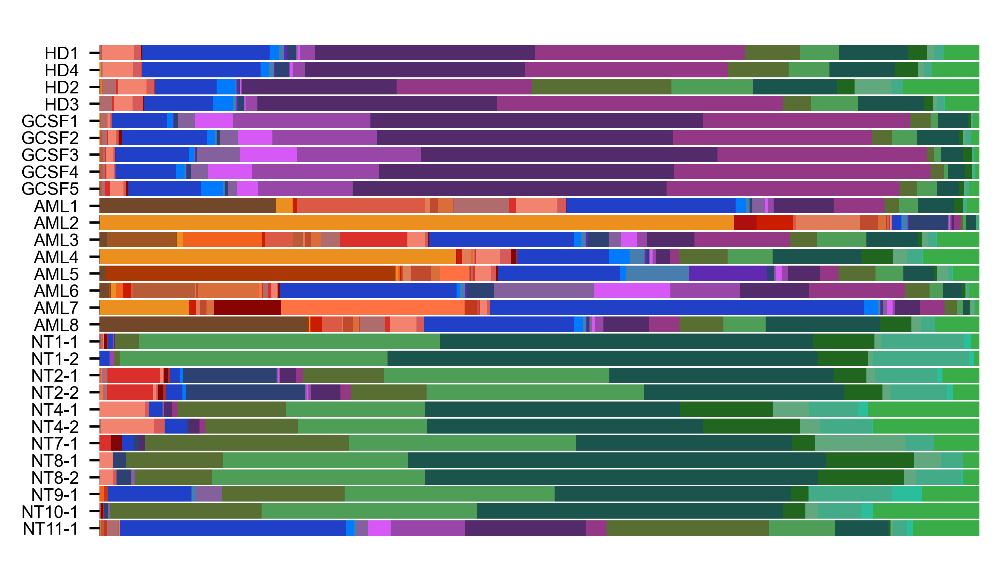

In [18]:
hbars(results, category_names, category_colors, plot_legend = False)

plt.savefig("figures/final/figure_patient_cell_type_refined_fraction_v4_fn.pdf", transparent = True)


/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWar

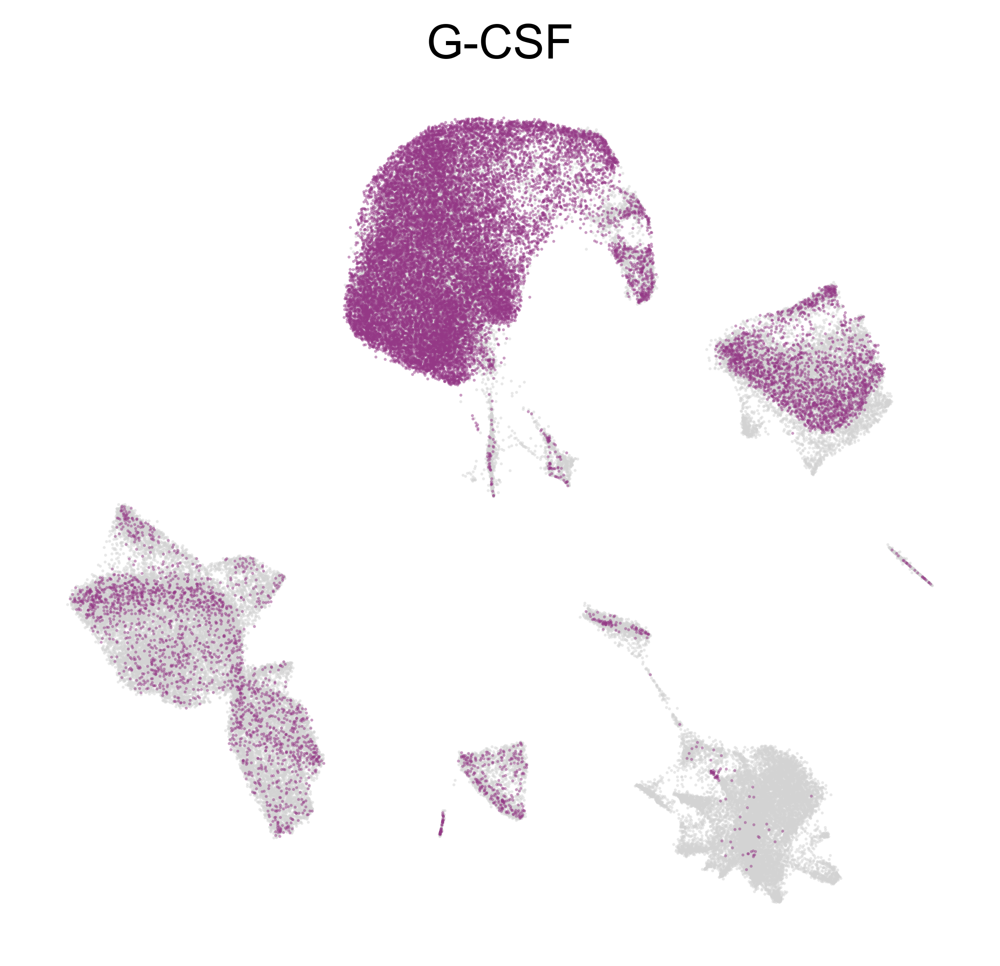

In [29]:
sc.settings.set_figure_params(dpi = 300, 
                              dpi_save = 1200, 
                              transparent = True, 
                              figsize = (5, 5), 
                              vector_friendly = False)


# To randomize cells
np.random.seed(69)
random_indices = np.random.permutation(list(range(adata.shape[0])))

fig = sc.pl.umap(adata[random_indices, :], color = ["sample_renamed"], groups = ["GCSF"], # #### # 
           alpha = 0.5, 
           wspace = 0.5,
           ncols = 3,
           s = 3, 
           frameon = False, title = "G-CSF",
           #legend_loc = "on data", 
           legend_loc = False,
           palette = code_color_palette,
           legend_fontsize = 10, legend_fontoutline = True, 
                show = False, return_fig = True)

fig.axes[0].set_aspect("equal")

fig.savefig("figures/final/figure_umap_gcsf_refined_v3.pdf", bbox_inches="tight")


/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWar

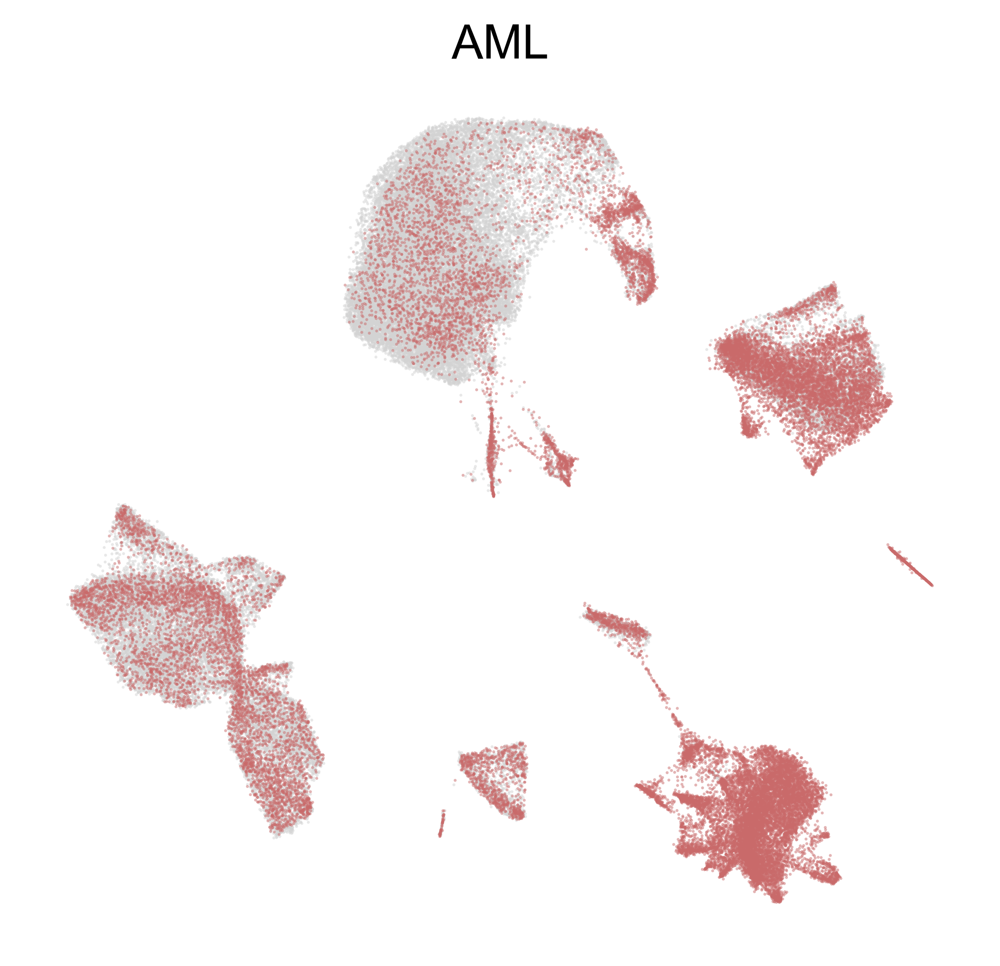

In [30]:
sc.settings.set_figure_params(dpi = 300, 
                              dpi_save = 1200, 
                              transparent = True, 
                              figsize = (5, 5), 
                              vector_friendly = False)


np.random.seed(69)
random_indices = np.random.permutation(list(range(adata.shape[0])))

fig = sc.pl.umap(adata[random_indices, :], color = ["sample_renamed"], groups = ["AML"], # #### # 
           alpha = 0.5, 
           wspace = 0.5,
           ncols = 3,
           s = 3, 
           frameon = False, title = "AML",
           #legend_loc = "on data", 
           legend_loc = False,
           palette = code_color_palette,
           legend_fontsize = 10, legend_fontoutline = True, 
                show = False, return_fig = True)

fig.axes[0].set_aspect("equal")
fig.savefig("figures/final/figure_umap_aml_refined_v3.pdf", bbox_inches="tight")

/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWar

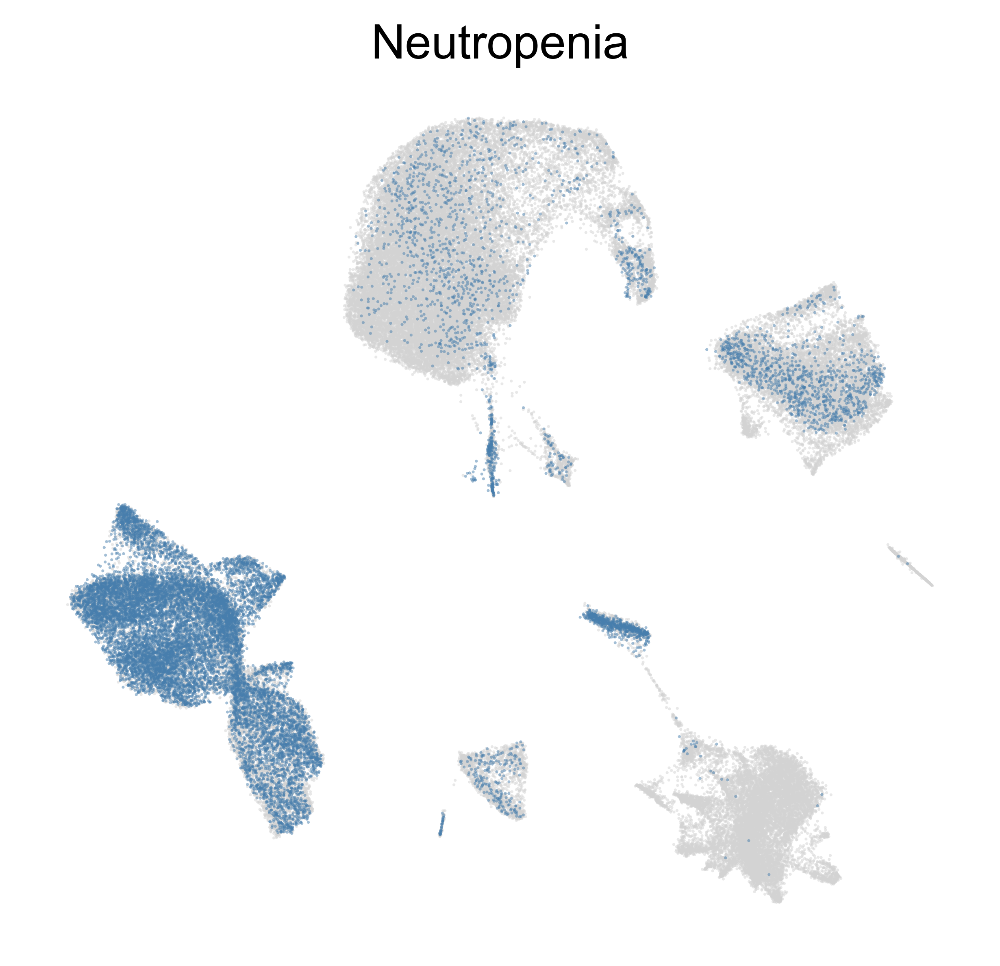

In [31]:
sc.settings.set_figure_params(dpi = 300, 
                              dpi_save = 1200, 
                              transparent = True, 
                              figsize = (5, 5), 
                              vector_friendly = False)


# To randomize cells
np.random.seed(69)
random_indices = np.random.permutation(list(range(adata.shape[0])))

fig = sc.pl.umap(adata[random_indices, :], color = ["sample_renamed"], groups = ["NT"], # #### # 
           alpha = 0.5, 
           wspace = 0.5,
           ncols = 3,
           s = 3, 
           frameon = False, title = "Neutropenia",
           #legend_loc = "on data", 
           legend_loc = False,
           palette = code_color_palette,
           legend_fontsize = 10, legend_fontoutline = True, 
                show = False, return_fig = True)

fig.axes[0].set_aspect("equal")
fig.savefig("figures/final/figure_umap_neutropenia_refined_v3.pdf", bbox_inches="tight")

/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWar

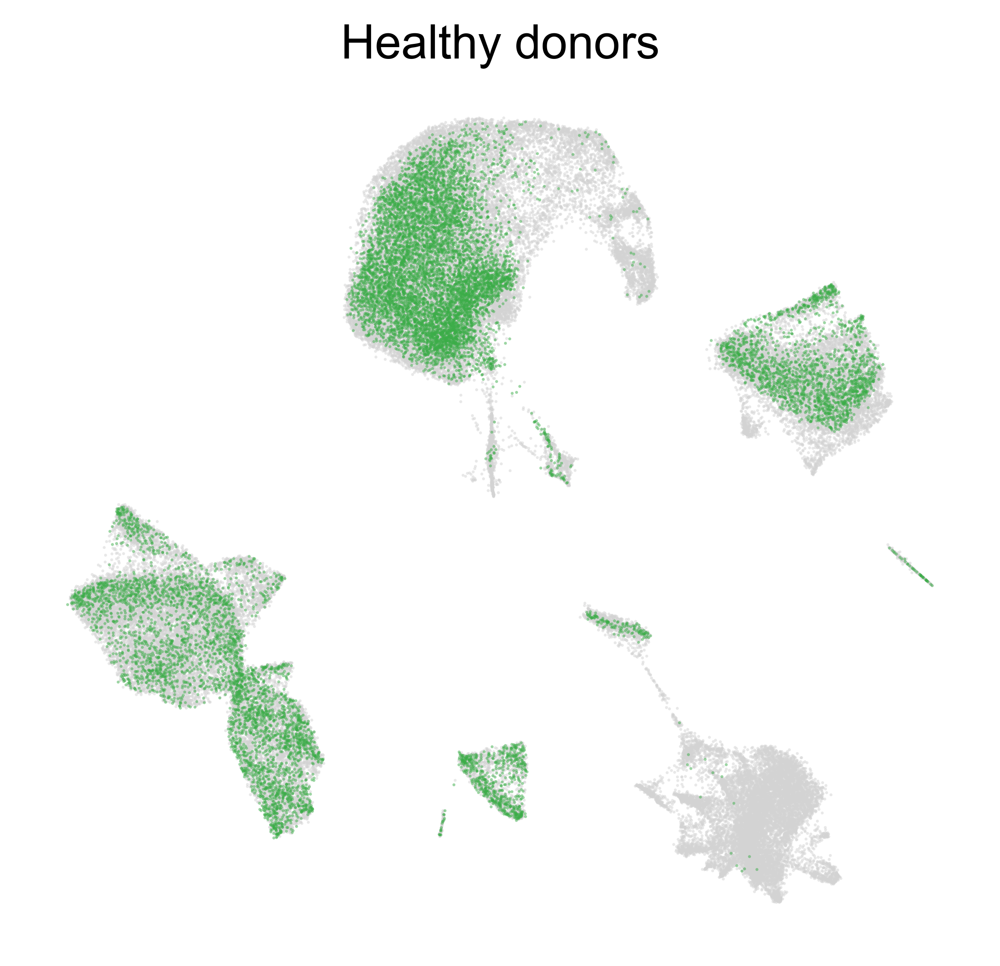

In [32]:
sc.settings.set_figure_params(dpi = 300, 
                              dpi_save = 1200, 
                              transparent = True, 
                              figsize = (5, 5), 
                              vector_friendly = False)


# To randomize cells
np.random.seed(69)
random_indices = np.random.permutation(list(range(adata.shape[0])))

fig = sc.pl.umap(adata[random_indices, :], color = ["sample_renamed"], groups = ["HD"], # #### # 
           alpha = 0.5, 
           wspace = 0.5,
           ncols = 3,
           s = 3, 
           frameon = False, title = "Healthy donors",
           #legend_loc = "on data", 
           legend_loc = False,
           palette = code_color_palette,
           legend_fontsize = 10, legend_fontoutline = True, 
                show = False, return_fig = True)

fig.axes[0].set_aspect("equal")
fig.savefig("figures/final/figure_umap_hd_refined_v3.pdf", bbox_inches="tight")


# Gene Expression

/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/denis/mambaforge/envs/capseq_dge/lib/python3.12/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


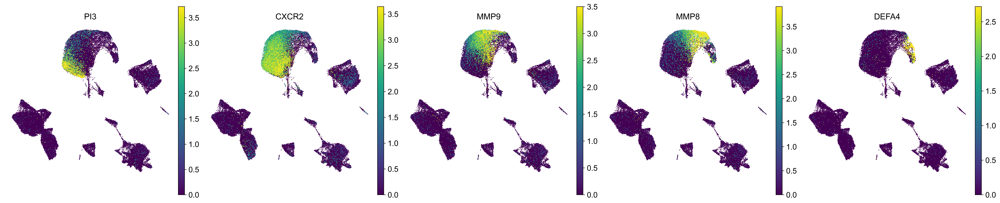

In [39]:
sc.settings.set_figure_params(dpi = 300, 
                              dpi_save = 1200, 
                              transparent = True, 
                              figsize = (5, 5), 
                              vector_friendly = False)

# To randomize cells
np.random.seed(69)
random_indices = np.random.permutation(list(range(adata.shape[0])))
adata_randomized = adata[random_indices, :]

genes_to_plot = ["PI3", "CXCR2", "MMP9", "MMP8", "DEFA4"]

ncols = 5
fig, axes = plt.subplots(1, ncols, figsize=(ncols * 5, 5), constrained_layout=True)

# Plot each gene on a separate subplot
for i, gene in enumerate(genes_to_plot):
    ax = axes[i]
    sc.pl.umap(
        adata_randomized,
        color=gene,
        size=5,
        alpha=1,
        frameon=False,
        vmax="p99.5",
        use_raw=False,
        ax=ax,
        show=False
    )
    ax.set_aspect("equal")
    ax.set_title(gene, fontsize=15)

plt.savefig("figures/final/neutrophils_markers.pdf")

plt.show()

In [20]:
cell_type_simple_color_palette = {

"Platelets": "#b06c6c",
"Erythrocytes": "#db2f2c",
"B cells": "#f2836f",
"Monocytes": "#2041c7",
"Dendritic cells": "#602ab0",
"Basophils": "#2d4173",
"Neutrophils": "#532b6b",
"T cells": "#1b544c",
"NK cells": "#3bad48",
}

In [21]:
# Dictionary for renaming
rename_dict = {
    "Cycling B cells" : "B cells",
    "Cycling T cells" : "T cells",

    "Tem/Temra cytotoxic T cells": "T cells",
    "Tem/Effector helper T cells": "T cells",
    "Tcm/Naive helper T cells": "T cells",
    "Tcm/Naive cytotoxic T cells": "T cells",
    "MAIT T cells": "T cells",
    "Regulatory T cells": "T cells",
    "Precursors of Neutrophils": "Neutrophils",
    "Early Immature Neutrophils": "Neutrophils",
    "Immature Neutrophils": "Neutrophils",
    "Mature Neutrophils": "Neutrophils",
    "Aged Neutrophils": "Neutrophils",
    "CD14 Monocytes": "Monocytes",
    "CD16 Monocytes": "Monocytes",
    "cDC": "Dendritic cells",
    "Naive B cells": "B cells",
    "Memory B cells": "B cells",
    "Plasma cells": "B cells",
    "NK cells": "NK cells",
    "Basophils": "Basophils",
    "pDC": "Dendritic cells",
    "Platelets": "Platelets",
    "Erythrocytes": "Erythrocytes",
    
}

cell_type_simplified_df = adata.obs.copy()
cell_type_simplified_df["cell_type_simplified"] = cell_type_simplified_df["cell_type_sub_prolif_anno"].map(rename_dict)
cell_type_simplified_df["cell_type_simplified"] = pd.Categorical(cell_type_simplified_df["cell_type_simplified"])
cell_type_simplified_df = cell_type_simplified_df.dropna(subset=["cell_type_simplified"])



In [22]:
# Subset only Neutrophils
cell_type_neutrophils = adata.obs.copy()
cell_type_neutrophils = cell_type_neutrophils[cell_type_neutrophils["cell_type_sub_prolif_anno"].str.contains("Neutrophils", na = False)]
cell_type_neutrophils["cell_type_sub_prolif_anno"] = cell_type_neutrophils["cell_type_sub_prolif_anno"].astype('category')


In [23]:

# Calculate cell counts per patient within each sample and cell type
cell_counts = cell_type_neutrophils.groupby(
    ["cell_type_sub_prolif_anno", "code_renamed", "sample_renamed"]
).size().reset_index(name="cell_count")


cell_counts = cell_counts[cell_counts["sample_renamed"] != "NT"]

# Filter rows where "sample_renamed" is a substring of "code_renamed"
cell_counts = cell_counts[cell_counts.apply(lambda row: row["sample_renamed"] in row["code_renamed"], axis=1)]

# Normalize cell counts as percentages per "code_renamed"
cell_counts["normalized_count"] = cell_counts.groupby("code_renamed")["cell_count"].transform(
    lambda x: (x / x.sum()) * 100
)



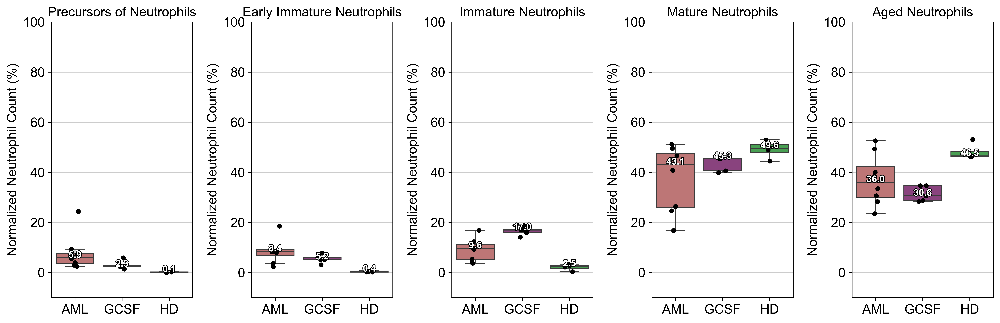

In [24]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import matplotlib.patheffects as path_effects


cell_types = cell_counts["cell_type_sub_prolif_anno"].unique()
cell_types = ['Precursors of Neutrophils', 'Early Immature Neutrophils', 'Immature Neutrophils', 'Mature Neutrophils', 'Aged Neutrophils']

num_cell_types = len(cell_types)
cols = 5 
rows = -(-num_cell_types // cols) 
fig, axes = plt.subplots(rows, cols, figsize=(15, 5 * rows), sharex=False)

axes = axes.flatten()

for i, cell_type in enumerate(cell_types):
    ax = axes[i]
    subset = cell_counts[cell_counts["cell_type_sub_prolif_anno"] == cell_type]
    
    sns.boxplot(
        data=subset,
        x="sample_renamed",
        y="normalized_count",
        hue = "sample_renamed",
        ax=ax,
        linewidth=1,
        showfliers = False,
        palette=code_color_palette
    )
    
    sns.stripplot(
        data=subset,
        x="sample_renamed",
        y="normalized_count",
        ax=ax,
        color="black",
        jitter=True,
        size=5
    )



    medians = subset.groupby("sample_renamed")["normalized_count"].median()
    for tick, label in enumerate(ax.get_xticklabels()):
        sample_name = label.get_text()
        median_val = medians.get(sample_name, np.nan)
        if not np.isnan(median_val): 
            text = ax.text(
                tick,
                median_val + 1, 
                f"{median_val:.1f}",
                horizontalalignment="center",
                verticalalignment="center",
                color="white",
                fontsize=10,
                weight="bold"
            )
            text.set_path_effects([
                path_effects.Stroke(linewidth=1.5, foreground='black'),
                path_effects.Normal()
            ])
    
    # Set titles and labels
    ax.set_title(f"{cell_type}")
    ax.set_ylabel("Normalized Neutrophil Count (%)")
    ax.set_xlabel("Sample Renamed")
    ax.set_ylim(-10, 100)
    ax.set_xlabel("")

for j in range(num_cell_types, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()

plt.show()

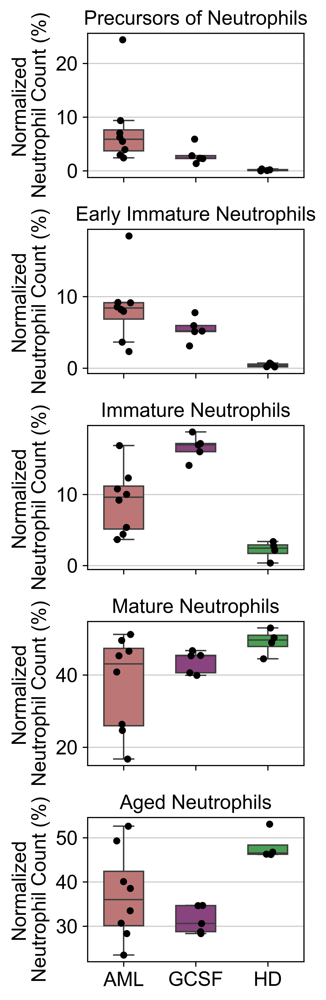

In [25]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import matplotlib.patheffects as path_effects


cell_types = cell_counts["cell_type_sub_prolif_anno"].unique()
cell_types = ['Precursors of Neutrophils', 'Early Immature Neutrophils', 'Immature Neutrophils', 'Mature Neutrophils', 'Aged Neutrophils']


num_cell_types = len(cell_types)
cols = 1 
rows = -(-num_cell_types // cols)  
fig, axes = plt.subplots(rows, cols, figsize=(5*0.66, 10), sharex=True)

axes = axes.flatten()

for i, cell_type in enumerate(cell_types):
    ax = axes[i]
    subset = cell_counts[cell_counts["cell_type_sub_prolif_anno"] == cell_type]
    
    sns.boxplot(
        data=subset,
        x="sample_renamed",
        y="normalized_count",
        hue = "sample_renamed",
        ax=ax,
        linewidth=1,
        showfliers = False,
        palette=code_color_palette,
        width=0.55
    )
    
    sns.stripplot(
        data=subset,
        x="sample_renamed",
        y="normalized_count",
        ax=ax,
        color="black",
        jitter=True,
        size=5
    )


    ax.set_title(f"{cell_type}")
    ax.set_ylabel("Normalized\nNeutrophil Count (%)")
    ax.set_xlabel("Sample Renamed")
    #ax.set_ylim(-10, 100)
    ax.set_xlabel("")

for j in range(num_cell_types, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig("figures/final/figure_boxplot_neutrophils_distribution_v6.pdf", transparent = True)
plt.show()

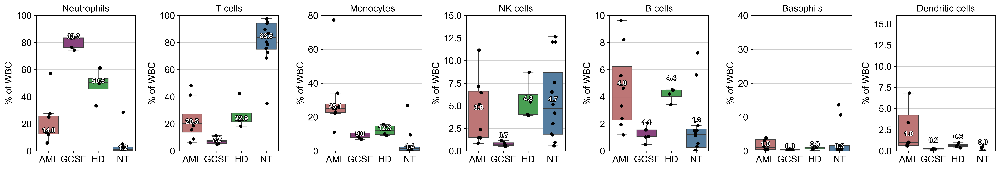

In [26]:
cell_type_not_aml_cells = cell_type_simplified_df.copy()
cell_type_not_aml_cells = cell_type_not_aml_cells[~(cell_type_not_aml_cells["cell_type_simplified"].str.contains("AML", na = False))]

cell_type_not_aml_cells["cell_type_simplified"] = cell_type_not_aml_cells["cell_type_simplified"].cat.remove_unused_categories()


cell_counts = cell_type_not_aml_cells.groupby(
    ["cell_type_simplified", "code_renamed", "sample_renamed"]
).size().reset_index(name="cell_count")
cell_counts = cell_counts[cell_counts.apply(lambda row: row["sample_renamed"] in row["code_renamed"], axis=1)]
cell_counts["normalized_count"] = cell_counts.groupby("code_renamed")["cell_count"].transform(
    lambda x: (x / x.sum()) * 100
)


sorted_by_hd = ["Neutrophils", "T cells", "Monocytes", "NK cells", "B cells", "Basophils", "Dendritic cells"]


import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import matplotlib.patheffects as path_effects


cell_types = cell_counts["cell_type_simplified"].unique()
cell_types = sorted_by_hd

num_cell_types = len(cell_types)
cols = 7
rows = -(-num_cell_types // cols) 
fig, axes = plt.subplots(rows, cols, figsize=(21, 5*0.75 * rows), sharex=False) #(x4)

axes = axes.flatten()

y_axis_limits = {
    "Neutrophils": (0, 100),
    "T cells": (0, 100),
    "Monocytes": (0, 80),
    "NK cells": (0, 15),
    "B cells": (0, 10),
    "Basophils": (0, 40),
    "Dendritic cells": (0, 16),
}

for i, cell_type in enumerate(cell_types):
    ax = axes[i]
    subset = cell_counts[cell_counts["cell_type_simplified"] == cell_type]
    
    sns.boxplot(
        data=subset,
        x="sample_renamed",
        y="normalized_count",
        hue = "sample_renamed",
        ax=ax,
        linewidth=1,
        showfliers = False,
        palette=code_color_palette
    )
    
    sns.stripplot(
        data=subset,
        x="sample_renamed",
        y="normalized_count",
        ax=ax,
        color="black",
        jitter=True,
        size=5
    )


    medians = subset.groupby("sample_renamed")["normalized_count"].median()
    for tick, label in enumerate(ax.get_xticklabels()):
        sample_name = label.get_text()
        median_val = medians.get(sample_name, np.nan)
        if not np.isnan(median_val): 
            text = ax.text(
                tick,
                median_val + 1, 
                f"{median_val:.1f}",
                horizontalalignment="center",
                verticalalignment="center",
                color="white",
                fontsize=10,
                weight="bold"
            )

            text.set_path_effects([
                path_effects.Stroke(linewidth=1.5, foreground='black'),
                path_effects.Normal()
            ])
    

    ax.set_title(f"{cell_type}")
    ax.set_ylabel("% of WBC")
    ax.set_xlabel("Sample Renamed")

    ax.set_xlabel("")


    if cell_type in y_axis_limits:
        ax.set_ylim(y_axis_limits[cell_type])
    
    ax.set_xlabel("")


for j in range(num_cell_types, len(axes)):
    fig.delaxes(axes[j])


plt.tight_layout()

plt.show()